# Network Analysis with Python 


This notebook contains exercises for getting started with network analysis in Python. The main topics we will cover in this class are:
1. Analysing a network
2. Plotting a network

In [1]:
# Install Networkx
! pip install networkx 

You are using pip version 8.1.2, however version 9.0.1 is available.
You should consider upgrading via the 'python -m pip install --upgrade pip' command.


In [2]:
import networkx as nx
import matplotlib.pyplot as plt

In [3]:
%matplotlib inline

In [4]:
G_fb = nx.read_edgelist("facebook_combined.txt", create_using = nx.Graph(), nodetype = int)

In [5]:
#Quick snapshot of the Network
print nx.info(G_fb)

Name: 
Type: Graph
Number of nodes: 4039
Number of edges: 88234
Average degree:  43.6910


In [7]:
#Create network layout for visualizations
spring_pos = nx.spring_layout(G_fb)

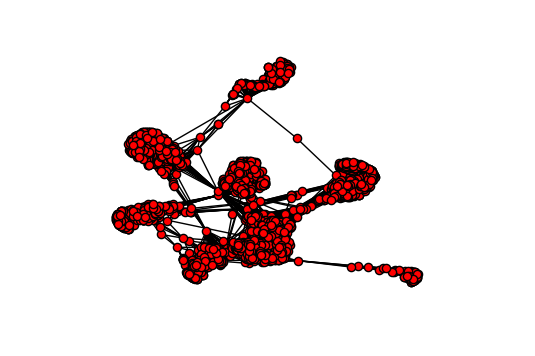

In [8]:
plt.axis("off")
nx.draw_networkx(G_fb, pos = spring_pos, with_labels = False, node_size = 35)

In [9]:
# What is the average clustering of the nodes in this graph?
nx.average_clustering(G_fb)

0.6055467186200871

In [10]:
# What is the average shortest path length?
nx.shortest_path(G_fb)

{0: {0: [0],
  1: [0, 1],
  2: [0, 2],
  3: [0, 3],
  4: [0, 4],
  5: [0, 5],
  6: [0, 6],
  7: [0, 7],
  8: [0, 8],
  9: [0, 9],
  10: [0, 10],
  11: [0, 11],
  12: [0, 12],
  13: [0, 13],
  14: [0, 14],
  15: [0, 15],
  16: [0, 16],
  17: [0, 17],
  18: [0, 18],
  19: [0, 19],
  20: [0, 20],
  21: [0, 21],
  22: [0, 22],
  23: [0, 23],
  24: [0, 24],
  25: [0, 25],
  26: [0, 26],
  27: [0, 27],
  28: [0, 28],
  29: [0, 29],
  30: [0, 30],
  31: [0, 31],
  32: [0, 32],
  33: [0, 33],
  34: [0, 34],
  35: [0, 35],
  36: [0, 36],
  37: [0, 37],
  38: [0, 38],
  39: [0, 39],
  40: [0, 40],
  41: [0, 41],
  42: [0, 42],
  43: [0, 43],
  44: [0, 44],
  45: [0, 45],
  46: [0, 46],
  47: [0, 47],
  48: [0, 48],
  49: [0, 49],
  50: [0, 50],
  51: [0, 51],
  52: [0, 52],
  53: [0, 53],
  54: [0, 54],
  55: [0, 55],
  56: [0, 56],
  57: [0, 57],
  58: [0, 58],
  59: [0, 59],
  60: [0, 60],
  61: [0, 61],
  62: [0, 62],
  63: [0, 63],
  64: [0, 64],
  65: [0, 65],
  66: [0, 66],
  67: [0, 67],


In [ ]:
# Do this make it a small-world like network? Is this what you would expect?

In [ ]:
from multiprocessing import Pool
import itertools

In [ ]:
def partitions(nodes, n):
    "Partitions the nodes into n subsets"
    nodes_iter = iter(nodes)
    while True:
        partition = tuple(itertools.islice(nodes_iter,n))
        if not partition:
            return
        yield partition

In [ ]:
def btwn_pool(G_tuple):
    return nx.betweenness_centrality_source(*G_tuple)

In [ ]:
def between_parallel(G, processes = None):
    p = Pool(processes=processes)
    part_generator = 4*len(p._pool)
    node_partitions = list(partitions(G.nodes(), int(len(G)/part_generator)))
    num_partitions = len(node_partitions)
 
    bet_map = p.map(btwn_pool,
                        zip([G]*num_partitions,
                        [True]*num_partitions,
                        [None]*num_partitions,
                        node_partitions))
 
    bt_c = bet_map[0]
    for bt in bet_map[1:]:
        for n in bt:
            bt_c[n] += bt[n]
    return bt_c

In [ ]:

bt = between_parallel(G_fb)
top = 10

max_nodes =  sorted(bt.iteritems(), key = lambda v: -v[1])[:top]
bt_values = [5]*len(G_fb.nodes())
bt_colors = [0]*len(G_fb.nodes())
for max_key, max_val in max_nodes:
    bt_values[max_key] = 150
    bt_colors[max_key] = 2
 
plt.axis("off")
nx.draw_networkx(G_fb, pos = spring_pos, cmap = plt.get_cmap("rainbow"), node_color = bt_colors, node_size = bt_values, with_labels = False)


## Extra Tasks##

see NetworkX documentation here https://networkx.github.io/documentation/networkx-1.9.1/reference/algorithms.html

1. Find the k-clique communities in this network
2. What is the centrality of node 14?
3. Run a hive plot of the data with 2 k-clique communities as the dimensions (follow  https://github.com/ericmjl/hiveplot)